# The purpose of this notebook is to explore different ways to visualize event-triggered spiking across ntrodes

### also to try out holoviews and some other tools


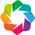


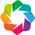

In [1]:
import loren_frank_data_processing as lfdp
import replay_classification as replay
import ripple_detection as ripple
import matplotlib.pyplot as plt
import holoviews as hv
import inspect
import os
import pandas as pd
import numpy as np
from ipywidgets import FloatProgress
from IPython.display import display
hv.notebook_extension('bokeh', 'matplotlib')
%matplotlib inline
%reload_ext autoreload
%autoreload 2
# %qtconsole
# %config InlineBackend.figure_format = 'retina'

In [5]:
animal_id = 'JZ1'
day, epoch = [1, 2]
ripple_area = 'ca1'
mu_areas = ['ca1', 'mec']
animals = {
    'JZ1': lfdp.Animal(short_name='JZ1', directory='../Raw-Data/JZ1')}
date = 20161114
epoch_index = ('JZ1', 1, 2)
areas = ['ca1']
mark_variables = ['channel_1_max', 'channel_2_max', 'channel_3_max',
                  'channel_4_max']

In [7]:
ntrode_df = lfdp.make_tetrode_dataframe(animals)
ntrode_keys = ntrode_df.xs(epoch_index, drop_level=False).index.values
ntrodes = ntrode_df.xs(epoch_index, drop_level=False).index.get_level_values('tetrode_number').tolist()
mec_ntrode_df = ntrode_df.xs(epoch_index, drop_level=False).query('area == "mec"')
ca1_ntrode_df = ntrode_df.xs(epoch_index, drop_level=False).query('area == "ca1"')

In [8]:
f = FloatProgress(min=0, max=ntrode_keys.shape[0])
f.value = 0
display(f)
mu_df = []
for key_num, ntrode_key in enumerate(ntrode_keys):
    mu_df.append(lfdp.get_multiunit_indicator_dataframe(ntrode_key, animals))
    f.value += 1

FloatProgress(value=0.0, max=30.0)

In [4]:
# os.system('subl {0}'.format(lfdp.core.__file__))

0

In [9]:
mec_ntrode_df = ntrode_df.xs(epoch_index, drop_level=False).query('area == "mec"')
ca1_ntrode_df = ntrode_df.xs(epoch_index, drop_level=False).query('area == "ca1"')

In [11]:
position_variables = ['linear_distance', 'trajectory_direction', 'speed']
position_df = lfdp.get_interpolated_position_dataframe(epoch_index, animals)
position_df['time'] = position_df.index #add the time index values as another col

In [12]:
hippocampus_lfps = lfdp.get_LFPs(ca1_ntrode_df.index, animals)
time = hippocampus_lfps.index
sampling_frequency = 1500

In [13]:
ripple_times = ripple.Kay_ripple_detector(
        time, hippocampus_lfps.values, position_df.speed.values, sampling_frequency,
        minimum_duration=pd.Timedelta(milliseconds=15), zscore_threshold=4)
window_offset = (-0.5, 0.5)

# Plot swr(ca1)-triggered spikes
    1. two datatype approachs
        a. spiketrain : pandas df with entry per timebin and col per ntrode
        b. spiketimes : pandas df with entry per spike and col of ntrodeID
    * need to try xarray

## spike-train

In [164]:
spike_train = pd.concat([(ntmu['channel_1_max'].notnull().astype('int')*(inum+1))
                         .rename('{0}'.format(inum+1), axis='columns')
                         for inum, ntmu in enumerate(mu_df)], axis=1)

In [922]:
spike_train.head()

,1,2,3,4,5,6,7,8,9,10,...,21,22,23,24,25,26,27,28,29,30
time,,,,,,,,,,,,,,,,,,,,,
00:28:00.085200,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
00:28:00.085867,0,2,3,4,0,0,0,8,0,10,...,21,0,23,24,25,26,0,0,29,30
00:28:00.086533,0,2,3,0,0,0,0,0,0,10,...,21,0,0,24,0,26,0,0,0,0
00:28:00.087200,0,0,0,4,0,6,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
00:28:00.087867,0,0,0,0,0,0,0,0,9,0,...,0,0,0,0,25,0,0,0,0,0


## spike-times

In [1115]:
spike_times = pd.concat([(ntmu['channel_1_max'].dropna().notnull().astype('int')*(inum+1))
                         .rename('ntrode', axis='columns')
                          for inum, ntmu in enumerate(mu_df)], axis=0).to_frame()#.reset_index().sort_values('time')
spike_times['ntrodeID'] = spike_times['ntrode'].astype('str')
spike_times['datetime'] = spike_times.index.to_datetime()
spike_times['seconds'] = spike_times.index.total_seconds()
spike_times.sort_index(inplace=True)

In [1116]:
spike_times.head()

,ntrode,ntrodeID,datetime,seconds
time,,,,
00:28:00.085867,16,16,1970-01-01 00:28:00.085867,1680.085867
00:28:00.085867,2,2,1970-01-01 00:28:00.085867,1680.085867
00:28:00.085867,14,14,1970-01-01 00:28:00.085867,1680.085867
00:28:00.085867,26,26,1970-01-01 00:28:00.085867,1680.085867
00:28:00.085867,13,13,1970-01-01 00:28:00.085867,1680.085867


# Several plotting approached
1. Matplotlib scatterplot via pandas {spike-train} abandoned bc too clunky
2. Holo Scatter {spike-times} DynamicMap ** need to fix
    a. i dunno what this buys me instead of Spikes
3. Holo Scatter with datashader {spike-times} 
    a. nice tool to use entire dataset.. need to explore how to toggle through certain event-bounds.. does datashader work with Spikes elements yet?
4. Holo Spikes {spike-train} HoloMap
    a. I like but need to fix to use spike-times.
5. Holo Spikes {spike-train} DynamicMap
    a. I like but need to fix to use spike-times.
6. Holo Image {spike-train} Holomap
    a. I like but need to figure out how to annotate ntrode, etc better
7. Holo Image {spike-train} DynamicMap
    a. I like but need to figure out how to annotate ntrode, etc better

 ideal: spike-times_df + datashade(HoloSpikes) + Holomap EventBounds

 realistic: spike-times_df + event HoloSpikes DynamicMap
 
 
 notes: sucks that DynamicMap can't use the scrubber

## 1. Matplotlib scatterplot via pandas {spike-train}
* need to fix the date formating for the xtick axis
* need to grab event triggered spikes

(1, 30)

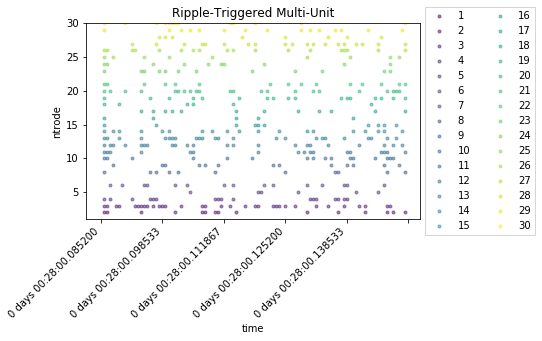

In [960]:
fig, ax = plt.subplots()
import matplotlib.dates as mdates
import matplotlib.ticker as mticks
ax = spike_train.iloc[0:100].plot(style='.',cmap='viridis', alpha=0.5, ax=ax)
plt.xlabel('time')
plt.ylabel('ntrode')
plt.title('Ripple-Triggered Multi-Unit')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=2,fancybox=False, shadow=False)
fig.autofmt_xdate(rotation=45)   
plt.ylim(int(spike_train.columns[0]), int(spike_train.columns[-1]))

## 3.  Scatter Approach with Datashader {spiketimes}
* handles massive datasets in browser by rasterizing and aggregating per zoom level

In [926]:
from holoviews.operation.datashader import datashade, dynspread

In [927]:
spike_times_hvds =hv.Dataset(spike_times, kdims=['seconds', 'ntrodeID'])
spike_times_scatter = spike_times_hvds.to(hv.Scatter, 'seconds', ['ntrode'], dynamic=True).overlay().relabel('per-rip MU')

In [928]:
%opts RGB {+axiswise} [show_grid=True width=800 height=500 bgcolor="black"]
# dynaspread helps aggregation visualiztion
dynspread(datashade(spike_times_scatter, cmap=dscolors.viridis))

:DynamicMap   []

## 2.  Holo Scatter {spike-times} DynamicMap
* need to fix

In [957]:
def get_spikes_scatter(event_number=0, spike_times=spike_times, ripple_times=ripple_times, ntrodes=ntrodes):
    event_spikes = spike_times[ripple_times.iloc[event_number].start_time:ripple_times.iloc[event_number].end_time]
    event_spikes.index = event_spikes.index.total_seconds()
    event_scatters = {i: hv.Scatter(event_spikes, kdims=['seconds', 'ntrodeID']) for i in ntrodes}
    return event_scatters

In [958]:
%%opts Scatter {+framewise} [width=600 height=400 xrotation=45 colorbar=True] (color=Palette('Category20') size=4)
dmap = hv.DynamicMap(get_spikes_scatter, kdims=['event_number'])
dmap.redim.range(event_number=((0,ripple_times.shape[0])))

Invoked as get_spikes_scatter(event_number=0)
Invoked as dynamic_operation(0)


AttributeError: 'Float64Index' object has no attribute 'total_seconds'

:DynamicMap   [event_number]

## 4. Holo Spikes {spike-times}

In [948]:
# ripspikes = [spike_train.loc[(ripvals.start_time - timedelta(seconds=.5)):(ripvals.end_time + timedelta(seconds=.5))] 
#              for irip, ripvals  in ripple_times.iterrows()]
# ripspiketimes = [[irip[irip[nti]>0].index.total_seconds() for nti in irip.columns] for irip in ripspikes]

In [615]:
dict_spec = {'Spikes':{'style':dict(color='grey')}, 
             'Spikes.multiunit':{'style':dict(color='grey')}, 
             'Spikes.multiunit.ca1': {'style':dict(color='blue')}, # 'plot':dict(interpolation='steps-mid')},
             'Spikes.multiunit.mec': {'style':dict(color='purple')}}

In [1131]:
spikes_Spikes_hmaps = get_event_spikes_hmaps(event_number=list(np.arange(ripple_times.shape[0])))
hmap_bounds = get_event_bounds_hmaps(event_number=list(np.arange(ripple_times.shape[0])))

### Holomaps take way too long.. use dynamicMap instead

In [1132]:
%%opts Spikes {+framewise} [height=400 width=800 bgcolor='black' spike_length=.9 tools=['hover']] (line_width=1)
%%opts Polygons {+framewise} (color='white' linewidth=10 alpha=.3)
%%output holomap='scrubber'
spikes_hmaps = hv.HoloMap(spikes_Spikes_hmaps, kdims=['event_number']).opts(dict_spec)
event_bounds_hmaps = hv.HoloMap(hmap_bounds, kdims=['event_number'])
spikes_hmaps * event_bounds_hmaps

KeyboardInterrupt: 

In [1130]:
def get_event_spikes_hmaps(event_number=0, spike_times=spike_times, event_times=ripple_times, window=.5, ntrodes=ntrodes):
    spikes_Spikes = {}
    for ievent, event_number in enumerate(event_number):
        event_start_time = event_times.iloc[event_number].start_time
        event_end_time = event_times.iloc[event_number].end_time
        window_start_time = event_start_time - timedelta(seconds=window)
        window_end_time = event_start_time + timedelta(seconds=window)
        window_spikes = spike_times[window_start_time:window_end_time]
        window_spikes.reset_index(inplace=True)
        spikes_Spikes[ievent] = hv.NdOverlay({nti: hv.Spikes(window_spikes[window_spikes.ntrode == nti].time,
                                                             kdims='time', group='multiunit',
                                                             label=ntrode_df.xs(epoch_index).area[nti])
                                              .opts(plot=dict(position=nti))
                                              for nti in ntrodes})
    return spikes_Spikes


def get_event_spikes_dmap(event_number=0, spike_times=spike_times, event_times=ripple_times, window=.5, ntrodes=ntrodes):
    event_start_time = event_times.iloc[event_number].start_time
    event_end_time = event_times.iloc[event_number].end_time
    window_start_time = event_start_time - timedelta(seconds=window)
    window_end_time = event_start_time + timedelta(seconds=window)
    window_spikes = spike_times[window_start_time:window_end_time]
    window_spikes.index = window_spikes.index.total_seconds()
    window_spikes.reset_index(inplace=True)

    spikes_Spikes = hv.NdOverlay({nti: hv.Spikes(window_spikes[window_spikes.ntrode == nti].time,
                                                 kdims='time', group='multiunit',
                                                 label=ntrode_df.xs(epoch_index).area[nti])
                                  .opts(plot=dict(position=nti))
                                  for nti in ntrodes}).opts(plot=dict(yticks=ntrodes))
    return spikes_Spikes


def get_event_bounds_hmaps(event_number=0, event_times=ripple_times, ntrodes=ntrodes):
    event_bounds = {}
    for ievent, event_number in enumerate(event_number):
        event_start_time = event_times.iloc[event_number].start_time
        event_end_time = event_times.iloc[event_number].end_time
        xbox_center = np.mean(
            [event_start_time.total_seconds(), event_end_time.total_seconds()])
        ybox_center = np.mean([min(ntrodes), max(ntrodes)])
        xbox_width = event_end_time.total_seconds() - event_start_time.total_seconds()
        ybox_width = max(ntrodes) - min(ntrodes)
        event_bounds[ievent] = hv.Polygons(
            [hv.Box(xbox_center, ybox_center, (xbox_width, ybox_width))])
    return event_bounds


def get_event_bounds_dmap(event_number=0, event_times=ripple_times, ntrodes=ntrodes):
    event_start_time = event_times.iloc[event_number].start_time
    event_end_time = event_times.iloc[event_number].end_time
    xbox_center = np.mean(
        [event_start_time.total_seconds(), event_end_time.total_seconds()])
    ybox_center = np.mean([min(ntrodes), max(ntrodes)+1])
    xbox_width = event_end_time.total_seconds() - event_start_time.total_seconds()
    ybox_width = (max(ntrodes) - min(ntrodes))+1
    event_bounds = hv.Polygons(
        [hv.Box(xbox_center, ybox_center, (xbox_width, ybox_width))])
    return event_bounds

## DynamicMap for Holo Spikes {spike-times}

In [19]:
import src.visualization as viz

In [22]:
%%opts Spikes {+framewise} [height=400 width=800 bgcolor='black' spike_length=.9 tools=['hover']] (line_width=1)
%%opts Polygons {+framewise} (color='white' linewidth=10 alpha=.3)

spikes_dmap = hv.DynamicMap(get_event_spikes_dmap, kdims=['event_number']).redim.range(event_number=((0,ripple_times.shape[0]))).opts(dict_spec)
event_bounds = hv.DynamicMap(get_event_bounds_dmap, kdims=['event_number']).redim.range(event_number=((0,ripple_times.shape[0])))
spikes_dmap * event_bounds

NameError: name 'get_event_spikes_dmap' is not defined

In [9]:
from src import visualization

## 5. Holo Image {spike-train} (Holomap, DynamicMap)
* need to fix to use spike-times directly
* how do I annotate/color by ntrode?

In [1086]:
def get_event_image_hmaps(event_number=0, spike_train=spike_train, event_times=ripple_times, window=.5, ntrodes=ntrodes):
    spikes_image = {}
    for ievent, event_number in enumerate(event_number):
        event_start_time = event_times.iloc[event_number].start_time
        event_end_time = event_times.iloc[event_number].end_time
        window_start_time = event_start_time - timedelta(seconds=window)
        window_end_time = event_start_time + timedelta(seconds=window)
        window_spikes = spike_train.loc[window_start_time:window_end_time]
        window_bounds = (window_start_time.total_seconds(), min(ntrodes), window_end_time.total_seconds(), max(ntrodes))
        spikes_image[ievent] = hv.Image(window_spikes.values.T, kdims=['time', 'ntrode'], vdims='spike', bounds=window_bounds)
    return spikes_image

def get_event_image_dmap(event_number=0, spike_train=spike_train, event_times=ripple_times, window=.5, ntrodes=ntrodes):
    event_start_time = event_times.iloc[event_number].start_time
    event_end_time = event_times.iloc[event_number].end_time
    window_start_time = event_start_time - timedelta(seconds=window)
    window_end_time = event_start_time + timedelta(seconds=window)
    window_spikes = spike_train.loc[window_start_time:window_end_time]
    window_bounds = (window_start_time.total_seconds(), min(ntrodes), window_end_time.total_seconds(), max(ntrodes))
    spikes_image = hv.Image(window_spikes.values.T, kdims=['time', 'ntrode'], vdims='spike', bounds=window_bounds)
    return spikes_image


### Image Method 1: HoloMap
* precompute all maps
* fast scrub through
* will take longer initially
* may overload browser if there's too much data
* doesn't require a server

In [898]:
hmap_data = get_event_image_hmaps(event_number=list(np.arange(ripple_times.shape[0])))
hmap_bounds = get_event_bounds_hmaps(event_number=list(np.arange(ripple_times.shape[0])))

In [900]:
%%opts Image {+framewise} [height=500 width=700]
%%opts Polygons {+framewise} (color='cyan' linewidth=5 alpha=.3)
%%output holomap='scrubber'

spikes_hmap = hv.HoloMap(hmap_data, kdims=['event_number'])
event_bounds_hmap = hv.HoloMap(hmap_bounds, kdims=['event_number'])
spikes_hmap * event_bounds_hmap

:HoloMap   [event_number]
   :Overlay
      .Image.I    :Image   [time,ntrode]   (spike)
      .Polygons.I :Polygons   [x,y]

### Image Method 2: DynamicMap
* won't overload browser
* quick initial frame
* but will take longer per func call
* requires a server 
* special scrubber at bottom doesn't work

In [1088]:
%%opts Image {+framewise} [height=500 width=700]
%%opts Polygons {+framewise} (color='cyan' linewidth=5 alpha=.3)

spikes_image = hv.DynamicMap(get_event_image_dmap, kdims=['event_number']).redim.range(event_number=((0,ripple_times.shape[0])))
event_bounds = hv.DynamicMap(get_event_bounds_dmap, kdims=['event_number']).redim.range(event_number=((0,ripple_times.shape[0])))
spikes_image * event_bounds


:DynamicMap   [event_number]